# GPU and Module

In [1]:
# GPU setting
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="3"

# modules setting3
import itertools
import os
import numpy as np
import glob
import pickle
import matplotlib.pyplot as plt
from matplotlib import cm
import matplotlib.image as mpimg
from mpl_toolkits.mplot3d import Axes3D
import tensorflow as tf
import random
import cv2
import time
import pandas as pd
from pandas import DataFrame
from sm_utils import load_data, batch_idxs, batch_flatten
from sklearn.metrics import confusion_matrix, classification_report, roc_curve, auc

%matplotlib inline

/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.5/dist-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

# Load Data

In [2]:
def load_data(phase, cls, lesion = None):
    """
    cls = 'negative', 'hemorrhagic', 'depressed', 'protruded'
    cls: [lesion]  
    'hemorrhagic': ['red_spot', 'angioectasia', 'active_bleeding'], 
    'depressed': ['erosion', 'ulcer', 'stricture'],
    'protruded': ['ampulla_of_vater', 'lymphoid_follicles', 'small_bowel_tumor']}
    phase = 'train', 'test'
    """
    if cls == 'negative':
        lesion = cls
    
    data_dir = '/mnt/disk2/data/private_data/SMhospital/capsule/1 preprocessed/sm/'
    
    path = os.path.join(data_dir, phase, cls, lesion)
    pathlist = glob.glob(path + '/*.jpg')

    data = []
    name = []

    for i in pathlist:
        temp = cv2.imread(i)
        temp_rgb = cv2.cvtColor(temp, cv2.COLOR_BGR2RGB)
        data.append(temp_rgb)
        name.append(os.path.basename(i))

    return np.asarray(data), np.asarray(name)

def one_hot(data, classes, nb_classes = 2):
    
    one_hot = [0]*nb_classes
    one_hot[classes] = 1
    
    label = np.vstack([one_hot for i in range(len(data))])

    return label

In [3]:
neg_data, neg_name = load_data('test', 'negative')
redspot_data, redspot_name = load_data('test', 'hemorrhagic', 'red_spot')
angio_data, angio_name = load_data('test', 'hemorrhagic', 'angioectasia')
active_data, active_name = load_data('test', 'hemorrhagic', 'active_bleeding')

neg_label = one_hot(neg_data, 0)
redspot_label = one_hot(redspot_data, 1)
angio_label = one_hot(angio_data, 1)
active_label = one_hot(active_data, 1)

print("negative:",neg_data.shape, neg_label.shape)
print("red spot:",redspot_data.shape, redspot_label.shape)
print("angioectasia:",angio_data.shape, angio_label.shape)
print("active_bleeding:",active_data.shape, active_label.shape)

negative: (12514, 512, 512, 3) (12514, 2)
red spot: (1112, 512, 512, 3) (1112, 2)
angioectasia: (37, 512, 512, 3) (37, 2)
active_bleeding: (858, 512, 512, 3) (858, 2)


# Import Model

In [4]:
def batch_output_shape(batch_output, mode = 'shape'):
    num_output = 0
    for i in range(len(batch_output)):
        num_output += len(batch_output[i])
    if mode == 'shape':
        return (num_output,) + batch_output[0][0].shape
    elif mode == 'num':
        return num_output

def batch_idx_mapping(batch_idx):
    batchsize = len(batch_idx[0])
    num_output = batch_output_shape(batch_idx, mode = 'num')
    mapping = []
    for i in range(num_output):
        mapping.append([i//batchsize, i%batchsize])
    return np.array(mapping)

In [5]:
# GradCAM utilities

def ReSizeMap(cam):
    """
    resize a heatmap from 4 x 4 into 512 x 512 and normalize to a value between 0 and 1 
    cam = (4, 4) / cam_re = (512, 512)
    """
    cam_re = cv2.resize(cam, (512, 512), interpolation=cv2.INTER_CUBIC)
    cam_re -= np.min(cam_re)
    cam_re /= np.max(cam_re) 

    return cam_re

def Map2RGB(cam_re):
    """
    convert the heatmap(512 x 512) to rgb image(512 x 512 x 3)
    cam_re = (512, 512) / cam_rgb = (512, 512, 3)
    """
    cam_rgba = cm.jet(cam_re) 
    cam_rgb = np.delete(cam_rgba, 3, 2)
    return cam_rgb

def DarkRGB(image, max_value = 7):
    """
    extract the dark parts of the sample image
    image = (512, 512, 3) 
    It extracts global variable only one time
    """
    r_0 = list(np.where(image.mean(axis=2) <= max_value))
    g_0 = r_0.copy()
    b_0 = r_0.copy()

    r_0.append(np.array([0 for i in range(len(r_0[0]))]))
    g_0.append(np.array([1 for i in range(len(g_0[0]))]))
    b_0.append(np.array([2 for i in range(len(b_0[0]))]))
    
    dark_rgb = [r_0, g_0, b_0]
    
    return dark_rgb

def ExcluDark(cam_rgb,dark_rgb):
    """
    exclude the heatmap within the dark parts of the image
    cam_rgb = (512, 512, 3) 
    """
    cam_rgb[tuple(dark_rgb[0])] = 0
    cam_rgb[tuple(dark_rgb[1])] = 0
    cam_rgb[tuple(dark_rgb[2])] = 0

    return cam_rgb

def OverLap(image, cam_rgb, alpha = 0.5):
    """
    overlap the heatmap on the image
    image, cam_rgb, return = (512, 512, 3) 
    """
    return cv2.addWeighted((image).astype('uint8'),1-alpha,(cam_rgb*255).astype('uint8'),alpha,0)

In [6]:
class Model:  
    def __init__(self, model_path, featuremap_name = ''):
        test_graph = tf.Graph()
        with test_graph.as_default():
            self.sess = tf.Session(graph = test_graph)
            loader = tf.train.import_meta_graph(model_path + '.meta')
            loader.restore(self.sess, model_path)

            self.is_training = test_graph.get_tensor_by_name('is_training:0')
            self.x = test_graph.get_tensor_by_name('img:0')
            self.featuremap = test_graph.get_tensor_by_name(featuremap_name + '/MaxPool:0')
            self.score = test_graph.get_tensor_by_name('score/BiasAdd:0')
    
    def compute_gradcam(self, image, grads, features, cam_phase = 'rgb'):
        weights = np.mean(grads, axis=(0, 1))
        channel = features.shape[-1]
        cam = np.zeros(features.shape[0:2])
        for i, w in enumerate(weights):
            cam += w * features[:, :, i]
            
        if cam_phase == 'heatmap':
            return cam 
        elif cam_phase == 'rgb':
            cam_re = ReSizeMap(cam)
            cam_rgb = Map2RGB(cam_re)
            cam_rgb = ExcluDark(cam_rgb, dark_rgb)
            return cam_rgb
        elif cam_phase == 'overlap':
            cam_final = OverLap(image, cam_rgb, alpha = 0.5)
            return cam_final
    
    def get_softmax(self, image):
        """
        image.shape = (None, 512, 512, 3)
        """
        softmax = self.sess.run(tf.nn.softmax(self.score), feed_dict={self.x: image, self.is_training: False})
        return softmax
    
    def get_gradcam(self, image, class_idx = 1, desired_cam = 'rgb'):
        """
        image.shape = (None, 512, 512, 3)
        """
        grad = tf.gradients(self.score[:, class_idx], self.featuremap)[0]
        grads, features = self.sess.run([grad, self.featuremap], feed_dict={self.x: image, self.is_training: False})
        cams = []
        for i, img in enumerate(image):
            gradcam = self.compute_gradcam(img, grads[i], features[i], cam_phase = desired_cam)
            cams.append(gradcam)  
        return np.asarray(cams)

In [19]:
model_dir = '/mnt/disk1/project/SMhospital/capsule/algorithm/ensemble/p3_2/v2.10/model/'
teacher_path = model_dir + 'NH_1908312018_5750_val_acc_1.00_val_loss_0.001598'

student_path = './model/conv6/' + 'NH_1911261800_4600_val_sen_100.00_val_loss_0.01480'
scratch_path = './model/conv6/' + 'NH_scratch_1911262059_6980_val_sen_100.00_val_loss_0.03533'

teacher_conv7_model = Model(teacher_path, featuremap_name = 'maxp7')
student_conv6_model = Model(student_path, featuremap_name = 'maxp6')
scratch_conv6_model = Model(scratch_path, featuremap_name = 'maxp6')

# Evaluation

## Accuracy per lesion

In [11]:
print("negative:",neg_data.shape, neg_label.shape)
print("red spot:",redspot_data.shape, redspot_label.shape)
print("angioectasia:",angio_data.shape, angio_label.shape)
print("active_bleeding:",active_data.shape, active_label.shape)

negative: (12514, 512, 512, 3) (12514, 2)
red spot: (1112, 512, 512, 3) (1112, 2)
angioectasia: (37, 512, 512, 3) (37, 2)
active_bleeding: (858, 512, 512, 3) (858, 2)


In [21]:
def model_pred(Model, image):
    b_idxs = batch_idxs(image)
    outputs = []
    start_time = time.time()
    for b_idx in b_idxs:
        softmax = Model.get_softmax(image[b_idx])
        outputs.append(softmax)
    time_taken = time.time() - start_time
    print("#: {} / Inference Time: {}".format(len(image), time.strftime("%H:%M:%S", time.gmtime(time_taken))))
    return batch_flatten(outputs)

def accuracy(data_y, outputs):
    pred = np.argmax(outputs, axis = 1)
    true = np.argmax(data_y, axis = 1)
    acc = 100*np.mean(np.equal(true, pred))
    print("Accuracy: {:.2f} %".format(acc))
    return acc

In [17]:
neg_t_output = model_pred(teacher_conv7_model, neg_data)
redspot_t_output = model_pred(teacher_conv7_model, redspot_data)
angio_t_output = model_pred(teacher_conv7_model, angio_data)
active_t_output = model_pred(teacher_conv7_model, active_data)

neg_t_acc = accuracy(neg_label, neg_t_output)
redspot_t_acc = accuracy(redspot_label, redspot_t_output)
angio_t_acc = accuracy(angio_label, angio_t_output)
active_t_acc = accuracy(active_label, active_t_output)

Inference Time: 00:00:30
Inference Time: 00:00:02
Inference Time: 00:00:00
Inference Time: 00:00:02
Accuracy: 97.71 %
Accuracy: 96.22 %
Accuracy: 100.00 %
Accuracy: 99.77 %


In [22]:
print("conv7\n")

neg_t_output = model_pred(teacher_conv7_model, neg_data)
redspot_t_output = model_pred(teacher_conv7_model, redspot_data)
angio_t_output = model_pred(teacher_conv7_model, angio_data)
active_t_output = model_pred(teacher_conv7_model, active_data)

print("")
print("conv6\n")

neg_stu_output = model_pred(student_conv6_model, neg_data)
redspot_stu_output = model_pred(student_conv6_model, redspot_data)
angio_stu_output = model_pred(student_conv6_model, angio_data)
active_stu_output = model_pred(student_conv6_model, active_data)

neg_scr_output = model_pred(scratch_conv6_model, neg_data)
redspot_scr_output = model_pred(scratch_conv6_model, redspot_data)
angio_scr_output = model_pred(scratch_conv6_model, angio_data)
active_scr_output = model_pred(scratch_conv6_model, active_data)

conv7

#: 12514 / Inference Time: 00:00:32
#: 1112 / Inference Time: 00:00:02
#: 37 / Inference Time: 00:00:00
#: 858 / Inference Time: 00:00:02

conv6

#: 12514 / Inference Time: 00:00:41
#: 1112 / Inference Time: 00:00:04
#: 37 / Inference Time: 00:00:00
#: 858 / Inference Time: 00:00:03
#: 12514 / Inference Time: 00:00:51
#: 1112 / Inference Time: 00:00:05
#: 37 / Inference Time: 00:00:00
#: 858 / Inference Time: 00:00:04


## student

In [14]:
student_path = './model/conv6/' + 'NH_1911261837_6040_val_sen_100.00_val_loss_0.00510'

neg_stu_output = model_pred(student_conv6_model, neg_data)
redspot_stu_output = model_pred(student_conv6_model, redspot_data)
angio_stu_output = model_pred(student_conv6_model, angio_data)
active_stu_output = model_pred(student_conv6_model, active_data)

neg_stu_acc = accuracy(neg_label, neg_stu_output)
redspot_stu_acc = accuracy(redspot_label, redspot_stu_output)
angio_stu_acc = accuracy(angio_label, angio_stu_output)
active_stu_acc = accuracy(active_label, active_stu_output)

Inference Time: 00:00:52
Inference Time: 00:00:05
Inference Time: 00:00:00
Inference Time: 00:00:03
Accuracy: 98.39 %
Accuracy: 95.23 %
Accuracy: 100.00 %
Accuracy: 98.60 %


In [17]:
student_path = './model/conv6/' + 'NH_1911261801_4630_val_sen_100.00_val_loss_0.00919'
student_conv6_model = Model(student_path, featuremap_name = 'maxp6')

neg_stu_output = model_pred(student_conv6_model, neg_data)
redspot_stu_output = model_pred(student_conv6_model, redspot_data)
angio_stu_output = model_pred(student_conv6_model, angio_data)
active_stu_output = model_pred(student_conv6_model, active_data)

neg_stu_acc = accuracy(neg_label, neg_stu_output)
redspot_stu_acc = accuracy(redspot_label, redspot_stu_output)
angio_stu_acc = accuracy(angio_label, angio_stu_output)
active_stu_acc = accuracy(active_label, active_stu_output)

Inference Time: 00:00:55
Inference Time: 00:00:05
Inference Time: 00:00:00
Inference Time: 00:00:04
Accuracy: 96.56 %
Accuracy: 96.31 %
Accuracy: 100.00 %
Accuracy: 99.30 %


In [19]:
student_path = './model/conv6/' + 'NH_1911261800_4600_val_sen_100.00_val_loss_0.01480'
student_conv6_model = Model(student_path, featuremap_name = 'maxp6')

neg_stu_output = model_pred(student_conv6_model, neg_data)
redspot_stu_output = model_pred(student_conv6_model, redspot_data)
angio_stu_output = model_pred(student_conv6_model, angio_data)
active_stu_output = model_pred(student_conv6_model, active_data)

neg_stu_acc = accuracy(neg_label, neg_stu_output)
redspot_stu_acc = accuracy(redspot_label, redspot_stu_output)
angio_stu_acc = accuracy(angio_label, angio_stu_output)
active_stu_acc = accuracy(active_label, active_stu_output)

Inference Time: 00:00:53
Inference Time: 00:00:05
Inference Time: 00:00:00
Inference Time: 00:00:04
Accuracy: 96.58 %
Accuracy: 96.85 %
Accuracy: 100.00 %
Accuracy: 99.65 %


In [21]:
student_path = './model/conv6/' + 'NH_1911261752_4260_val_sen_100.00_val_loss_0.01521'
student_conv6_model = Model(student_path, featuremap_name = 'maxp6')

neg_stu_output = model_pred(student_conv6_model, neg_data)
redspot_stu_output = model_pred(student_conv6_model, redspot_data)
angio_stu_output = model_pred(student_conv6_model, angio_data)
active_stu_output = model_pred(student_conv6_model, active_data)

neg_stu_acc = accuracy(neg_label, neg_stu_output)
redspot_stu_acc = accuracy(redspot_label, redspot_stu_output)
angio_stu_acc = accuracy(angio_label, angio_stu_output)
active_stu_acc = accuracy(active_label, active_stu_output)

Inference Time: 00:00:55
Inference Time: 00:00:05
Inference Time: 00:00:00
Inference Time: 00:00:04
Accuracy: 97.70 %
Accuracy: 94.96 %
Accuracy: 100.00 %
Accuracy: 99.18 %


In [23]:
student_path = './model/conv6/' + 'NH_1911261723_3080_val_sen_100.00_val_loss_0.01640'
student_conv6_model = Model(student_path, featuremap_name = 'maxp6')

neg_stu_output = model_pred(student_conv6_model, neg_data)
redspot_stu_output = model_pred(student_conv6_model, redspot_data)
angio_stu_output = model_pred(student_conv6_model, angio_data)
active_stu_output = model_pred(student_conv6_model, active_data)

neg_stu_acc = accuracy(neg_label, neg_stu_output)
redspot_stu_acc = accuracy(redspot_label, redspot_stu_output)
angio_stu_acc = accuracy(angio_label, angio_stu_output)
active_stu_acc = accuracy(active_label, active_stu_output)

Inference Time: 00:00:56
Inference Time: 00:00:05
Inference Time: 00:00:00
Inference Time: 00:00:04
Accuracy: 98.15 %
Accuracy: 91.82 %
Accuracy: 100.00 %
Accuracy: 99.18 %


### best

In [14]:
student_path = './model/conv6/' + 'NH_1911261800_4600_val_sen_100.00_val_loss_0.01480'
student_conv6_model = Model(student_path, featuremap_name = 'maxp6')

In [16]:
neg_stu_output = model_pred(student_conv6_model, neg_data)
redspot_stu_output = model_pred(student_conv6_model, redspot_data)
angio_stu_output = model_pred(student_conv6_model, angio_data)
active_stu_output = model_pred(student_conv6_model, active_data)

neg_stu_acc = accuracy(neg_label, neg_stu_output)
redspot_stu_acc = accuracy(redspot_label, redspot_stu_output)
angio_stu_acc = accuracy(angio_label, angio_stu_output)
active_stu_acc = accuracy(active_label, active_stu_output)

Inference Time: 00:00:42
Inference Time: 00:00:04
Inference Time: 00:00:00
Inference Time: 00:00:03
Accuracy: 96.58 %
Accuracy: 96.85 %
Accuracy: 100.00 %
Accuracy: 99.65 %


## scratch

In [15]:
scratch_path = './model/conv6/' + 'NH_scratch_1911262059_6980_val_sen_100.00_val_loss_0.03533'

neg_scr_output = model_pred(scratch_conv6_model, neg_data)
redspot_scr_output = model_pred(scratch_conv6_model, redspot_data)
angio_scr_output = model_pred(scratch_conv6_model, angio_data)
active_scr_output = model_pred(scratch_conv6_model, active_data)

neg_scr_acc = accuracy(neg_label, neg_scr_output)
redspot_scr_acc = accuracy(redspot_label, redspot_scr_output)
angio_scr_acc = accuracy(angio_label, angio_scr_output)
active_scr_acc = accuracy(active_label, active_scr_output)

Inference Time: 00:01:03
Inference Time: 00:00:06
Inference Time: 00:00:00
Inference Time: 00:00:05
Accuracy: 94.98 %
Accuracy: 95.68 %
Accuracy: 100.00 %
Accuracy: 99.42 %


In [24]:
scratch_path = './model/conv6/' + 'NH_scratch_1911262053_6520_val_sen_100.00_val_loss_0.04392'
scratch_conv6_model = Model(scratch_path, featuremap_name = 'maxp6')

neg_scr_output = model_pred(scratch_conv6_model, neg_data)
redspot_scr_output = model_pred(scratch_conv6_model, redspot_data)
angio_scr_output = model_pred(scratch_conv6_model, angio_data)
active_scr_output = model_pred(scratch_conv6_model, active_data)

neg_scr_acc = accuracy(neg_label, neg_scr_output)
redspot_scr_acc = accuracy(redspot_label, redspot_scr_output)
angio_scr_acc = accuracy(angio_label, angio_scr_output)
active_scr_acc = accuracy(active_label, active_scr_output)

Inference Time: 00:01:07
Inference Time: 00:00:06
Inference Time: 00:00:00
Inference Time: 00:00:05
Accuracy: 96.65 %
Accuracy: 90.83 %
Accuracy: 100.00 %
Accuracy: 99.30 %


In [25]:
scratch_path = './model/conv6/' + 'NH_scratch_1911262048_6140_val_sen_100.00_val_loss_0.04734'
scratch_conv6_model = Model(scratch_path, featuremap_name = 'maxp6')

neg_scr_output = model_pred(scratch_conv6_model, neg_data)
redspot_scr_output = model_pred(scratch_conv6_model, redspot_data)
angio_scr_output = model_pred(scratch_conv6_model, angio_data)
active_scr_output = model_pred(scratch_conv6_model, active_data)

neg_scr_acc = accuracy(neg_label, neg_scr_output)
redspot_scr_acc = accuracy(redspot_label, redspot_scr_output)
angio_scr_acc = accuracy(angio_label, angio_scr_output)
active_scr_acc = accuracy(active_label, active_scr_output)

Inference Time: 00:01:07
Inference Time: 00:00:06
Inference Time: 00:00:00
Inference Time: 00:00:05
Accuracy: 95.40 %
Accuracy: 89.84 %
Accuracy: 100.00 %
Accuracy: 99.30 %


In [26]:
scratch_path = './model/conv6/' + 'NH_scratch_1911262048_6130_val_sen_96.00_val_loss_0.06651'
scratch_conv6_model = Model(scratch_path, featuremap_name = 'maxp6')

neg_scr_output = model_pred(scratch_conv6_model, neg_data)
redspot_scr_output = model_pred(scratch_conv6_model, redspot_data)
angio_scr_output = model_pred(scratch_conv6_model, angio_data)
active_scr_output = model_pred(scratch_conv6_model, active_data)

neg_scr_acc = accuracy(neg_label, neg_scr_output)
redspot_scr_acc = accuracy(redspot_label, redspot_scr_output)
angio_scr_acc = accuracy(angio_label, angio_scr_output)
active_scr_acc = accuracy(active_label, active_scr_output)

Inference Time: 00:01:07
Inference Time: 00:00:06
Inference Time: 00:00:00
Inference Time: 00:00:05
Accuracy: 95.88 %
Accuracy: 89.84 %
Accuracy: 100.00 %
Accuracy: 99.07 %


In [27]:
scratch_path = './model/conv6/' + 'NH_scratch_1911262037_5360_val_sen_98.00_val_loss_0.07135'
scratch_conv6_model = Model(scratch_path, featuremap_name = 'maxp6')

neg_scr_output = model_pred(scratch_conv6_model, neg_data)
redspot_scr_output = model_pred(scratch_conv6_model, redspot_data)
angio_scr_output = model_pred(scratch_conv6_model, angio_data)
active_scr_output = model_pred(scratch_conv6_model, active_data)

neg_scr_acc = accuracy(neg_label, neg_scr_output)
redspot_scr_acc = accuracy(redspot_label, redspot_scr_output)
angio_scr_acc = accuracy(angio_label, angio_scr_output)
active_scr_acc = accuracy(active_label, active_scr_output)

Inference Time: 00:01:08
Inference Time: 00:00:06
Inference Time: 00:00:00
Inference Time: 00:00:05
Accuracy: 95.28 %
Accuracy: 84.89 %
Accuracy: 100.00 %
Accuracy: 99.30 %


### best

In [ ]:
scratch_path = './model/conv6/' + 'NH_scratch_1911262059_6980_val_sen_100.00_val_loss_0.03533'
scratch_conv6_model = Model(scratch_path, featuremap_name = 'maxp6')

In [29]:
neg_scr_output = model_pred(scratch_conv6_model, neg_data)
redspot_scr_output = model_pred(scratch_conv6_model, redspot_data)
angio_scr_output = model_pred(scratch_conv6_model, angio_data)
active_scr_output = model_pred(scratch_conv6_model, active_data)

neg_scr_acc = accuracy(neg_label, neg_scr_output)
redspot_scr_acc = accuracy(redspot_label, redspot_scr_output)
angio_scr_acc = accuracy(angio_label, angio_scr_output)
active_scr_acc = accuracy(active_label, active_scr_output)

Inference Time: 00:01:09
Inference Time: 00:00:06
Inference Time: 00:00:00
Inference Time: 00:00:05
Accuracy: 94.98 %
Accuracy: 95.68 %
Accuracy: 100.00 %
Accuracy: 99.42 %


## Confustion Matrix

In [30]:
def con_mat(data_y, outputs):
    pred = np.argmax(outputs, axis = 1)
    true = np.argmax(data_y, axis = 1)
    return confusion_matrix(true, pred)

def plot_con_mat(cm, value_size = 15, label_size = 10, mode = 'percent'):
    plt.imshow(cm, interpolation = 'nearest', cmap = plt.cm.Blues)
    thresh = cm.max()/2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if mode == 'percent':
            value = np.round(cm[i, j]/(np.sum(cm, 1)[i]), 3)
        if mode == 'num':
            value = cm[i, j]
        plt.text(j, i, value,
                 fontsize = value_size,
                 horizontalalignment = 'center',
                 color = 'white' if cm[i, j] > thresh else 'black')
    plt.ylabel('True label', fontsize = label_size)
    plt.xlabel('Predicted', fontsize = label_size)
    plt.xticks([0, 1], ['nor', 'abnor'], rotation=0, fontsize = label_size)
    plt.yticks([0, 1], ['nor', 'abnor'], rotation=90, fontsize = label_size)
    
def metric(confusion_matrix):
    """
    A confusion matrix for Binary classification
    2x2 array: [[TN, FN],[FP, TP]]
    """
    Acc = (confusion_matrix[0, 0] + confusion_matrix[1, 1]) / np.sum(confusion_matrix)
    Sen = confusion_matrix[1, 1] / (confusion_matrix[1, 0] + confusion_matrix[1, 1])
    Spec = confusion_matrix[0, 0] / (confusion_matrix[0, 0] + confusion_matrix[0, 1])
    NPV = confusion_matrix[0, 0] / (confusion_matrix[0, 0] + confusion_matrix[1, 0])
    PPV = confusion_matrix[1, 1] / (confusion_matrix[0, 1] + confusion_matrix[1, 1])
    return [Acc, Sen, Spec, NPV, PPV]

In [34]:
t_outputs = np.vstack([neg_t_output, redspot_t_output, angio_t_output, active_t_output])
stu_outputs = np.vstack([neg_stu_output, redspot_stu_output, angio_stu_output, active_stu_output])
scr_outputs = np.vstack([neg_scr_output, redspot_scr_output, angio_scr_output, active_scr_output])
labels = np.vstack([neg_label, redspot_label, angio_label, active_label])

CM_t = con_mat(labels, t_outputs)
CM_stu = con_mat(labels, stu_outputs)
CM_scr = con_mat(labels, scr_outputs)

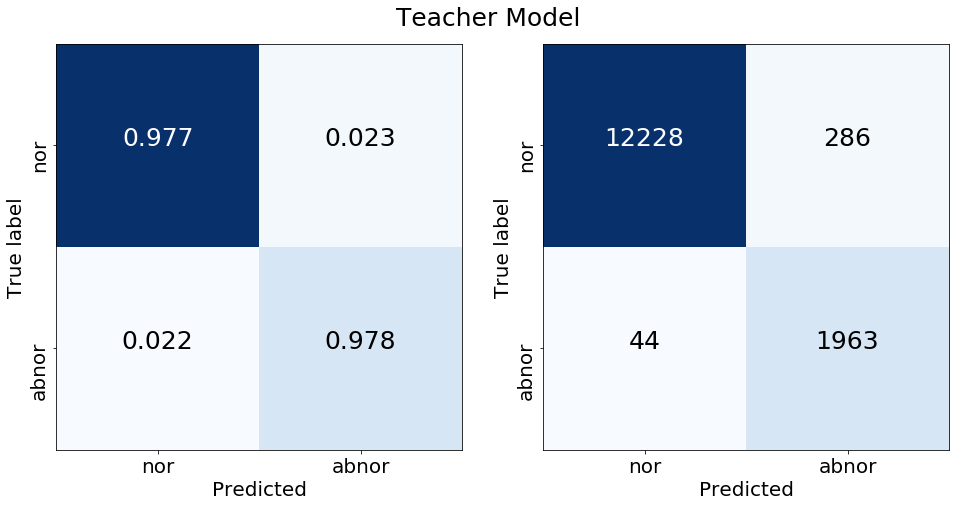

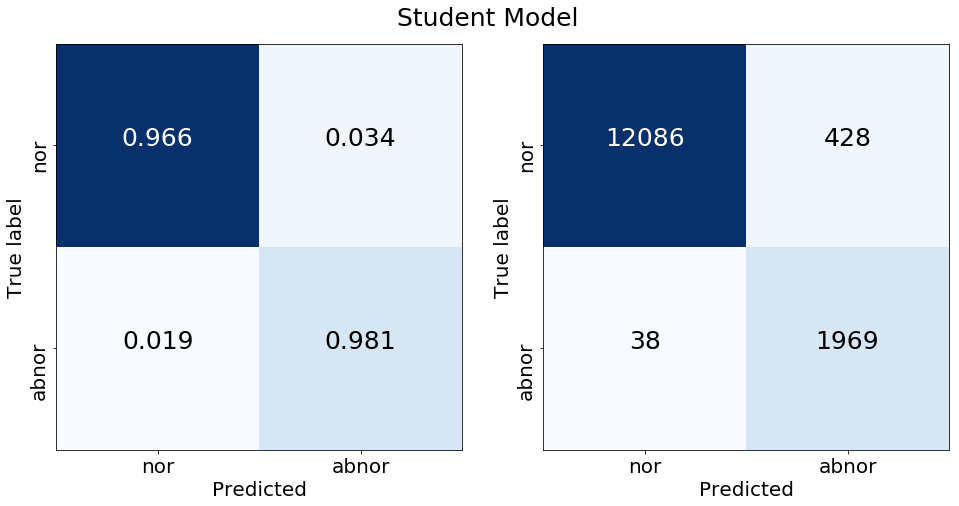

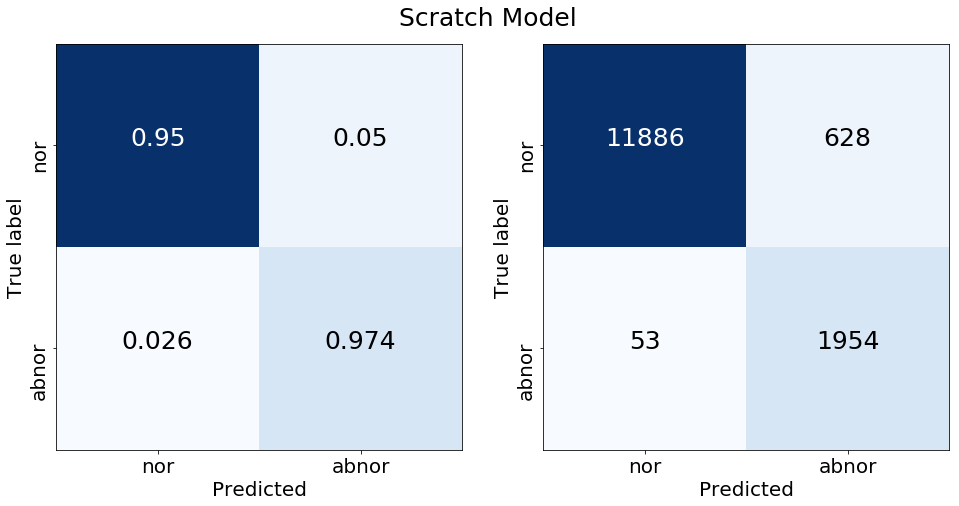

In [35]:
plt.figure(figsize=(16, 8))
plt.suptitle("Teacher Model", y = 0.92, fontsize = 25)
plt.subplot(121)
plot_con_mat(CM_t, value_size = 25, label_size = 20)
plt.subplot(122)
plot_con_mat(CM_t, value_size = 25, label_size = 20, mode = 'num')
plt.show()

plt.figure(figsize=(16, 8))
plt.suptitle("Student Model", y = 0.92, fontsize = 25)
plt.subplot(121)
plot_con_mat(CM_stu, value_size = 25, label_size = 20)
plt.subplot(122)
plot_con_mat(CM_stu, value_size = 25, label_size = 20, mode = 'num')
plt.show()

plt.figure(figsize=(16, 8))
plt.suptitle("Scratch Model", y = 0.92, fontsize = 25)
plt.subplot(121)
plot_con_mat(CM_scr, value_size = 25, label_size = 20)
plt.subplot(122)
plot_con_mat(CM_scr, value_size = 25, label_size = 20, mode = 'num')
plt.show()

In [49]:
Comparison_df = DataFrame(columns=(["Model", "Accuracy", "Sensitivity", "Specificity", "NPV", "PPV"]))
model_name = ['Teacher model (conv7)', 'Student model (conv6)', 'Scratch model (conv6)']
total_values = np.vstack([metric(CM_t), metric(CM_stu), metric(CM_scr)])*100

for i, v in zip(range(3), total_values):
    Comparison_df.loc[i] = [model_name[i], v[0], v[1], v[2], v[3], v[4]]  
Comparison_df.head()   

,Model,Accuracy,Sensitivity,Specificity,NPV,PPV
0,Teacher model (conv7),97.727429,97.807673,97.714560,99.641460,87.283237
1,Student model (conv6),96.790855,98.106627,96.579831,99.686572,82.144347
2,Scratch model (conv6),95.310240,97.359243,94.981621,99.556077,75.677769


# GradCAM

In [50]:
def confusion_idx(data_y, outputs, cls = 'positive'):
    pred = np.argmax(outputs, axis = 1)
    true = np.argmax(data_y, axis = 1)
    if cls == 'positive':
        fn_idx = np.where(true - pred == 1)[0]
        tp_idx = np.setxor1d(np.where(true == 1), fn_idx)
        return tp_idx, fn_idx
    elif cls == 'negative':
        fp_idx = np.where(true - pred == -1)[0]
        tn_idx = np.setxor1d(np.where(true == 0), fp_idx)
        return tn_idx, fp_idx
    
def plot_heatmap(heatmap, font_size = 15):
    plt.imshow(heatmap, cmap = 'jet')
    width, height = heatmap.shape[0], heatmap.shape[1]
    for i, j in itertools.product(range(width), range(height)):
        plt.text(j, i, np.round(heatmap[i, j], 2),
                 fontsize = font_size,
                 horizontalalignment = 'center', color = 'white' if heatmap[i, j] < np.sum(heatmap)/(width*height) else 'black')
    plt.axis('off')

"""
image = np.expand_dims(angio_data[11], axis = 0)
dark_rgb = DarkRGB(image[0])

with open('dark_rgb.pickle', 'wb') as f:
    pickle.dump(dark_rgb, f)
"""

with open('dark_rgb.pickle', 'rb') as f:
    dark_rgb = pickle.load(f)

## Red spot

In [114]:
tp_t_idx, fn_t_idx = confusion_idx(redspot_label, redspot_t_output, cls = 'positive')
tp_stu_idx, fn_stu_idx = confusion_idx(redspot_label, redspot_stu_output, cls = 'positive')
tp_scr_idx, fn_scr_idx = confusion_idx(redspot_label, redspot_scr_output, cls = 'positive')

print("Teacher: TPs = {}, FNs = {}".format(len(tp_t_idx), len(fn_t_idx)))
print("Student: TPs = {}, FNs = {}".format(len(tp_stu_idx), len(fn_stu_idx)))
print("Scratch: TPs = {}, FNs = {}".format(len(tp_scr_idx), len(fn_scr_idx)))

Teacher: TPs = 1070, FNs = 42
Student: TPs = 1077, FNs = 35
Scratch: TPs = 1064, FNs = 48


In [115]:
tp_idx = np.intersect1d(tp_t_idx, tp_stu_idx)
tp_idx = np.intersect1d(tp_idx, tp_scr_idx)

fn_idx = np.intersect1d(fn_t_idx, fn_stu_idx)
fn_idx = np.intersect1d(fn_idx, fn_scr_idx)

print("Common TPs = {}, FNs = {}".format(len(tp_idx), len(fn_idx)))

Common TPs = 1032, FNs = 15


### TP

In [59]:
b_idxs = batch_idxs(tp_idx)

In [61]:
t_cams, stu_cams, scr_cams = [], [], []
for b_idx in b_idxs:
    t_cam = teacher_conv7_model.get_gradcam(redspot_data[tp_idx[b_idx]])
    stu_cam = student_conv6_model.get_gradcam(redspot_data[tp_idx[b_idx]])
    scr_cam = scratch_conv6_model.get_gradcam(redspot_data[tp_idx[b_idx]])
    t_cams.append(t_cam)
    stu_cams.append(stu_cam)
    scr_cams.append(scr_cam)

In [62]:
t_cams = batch_flatten(t_cams)
stu_cams = batch_flatten(stu_cams)
scr_cams = batch_flatten(scr_cams)

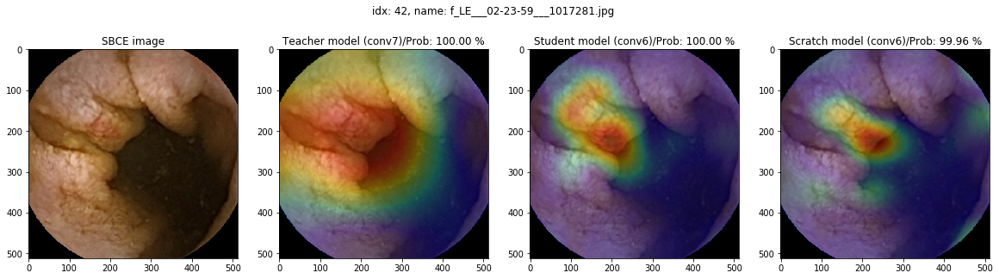

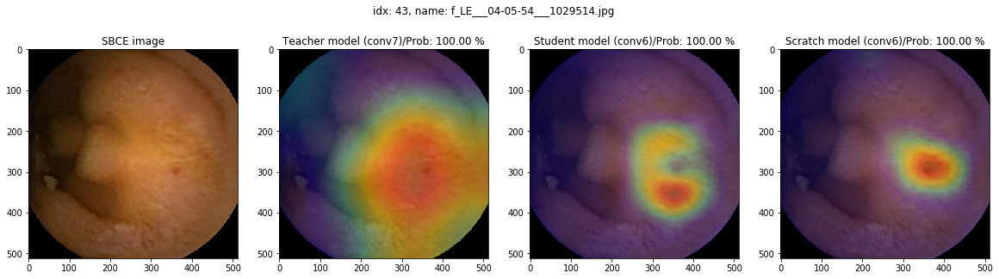

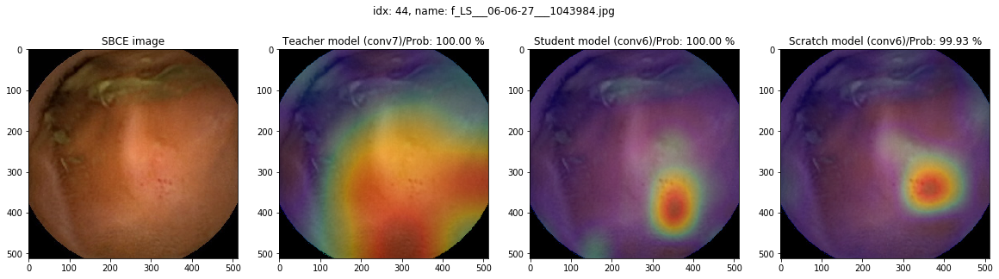

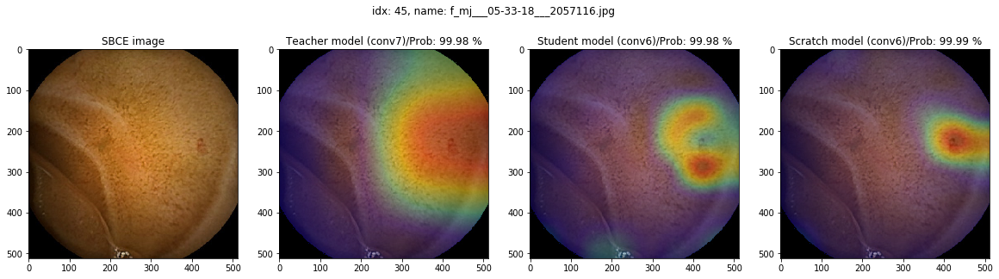

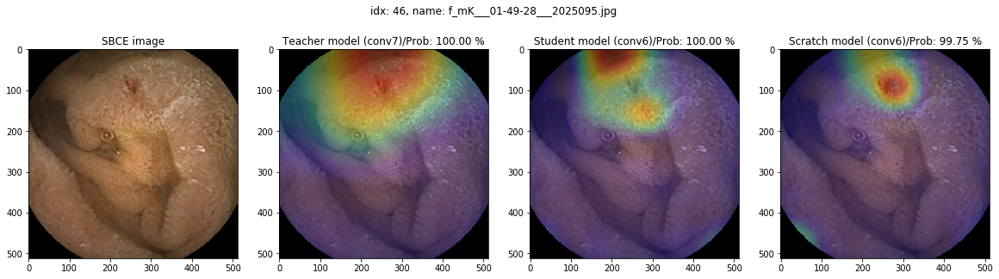

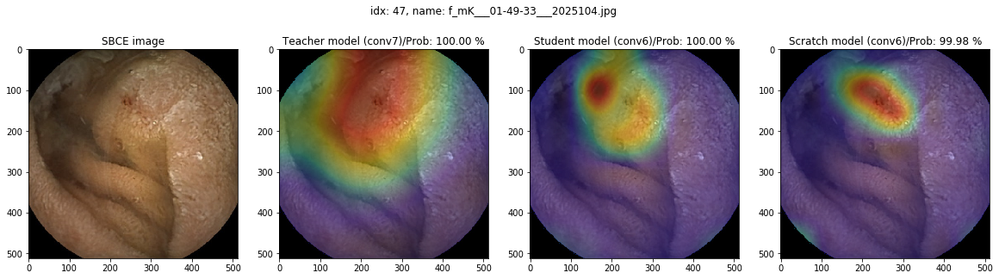

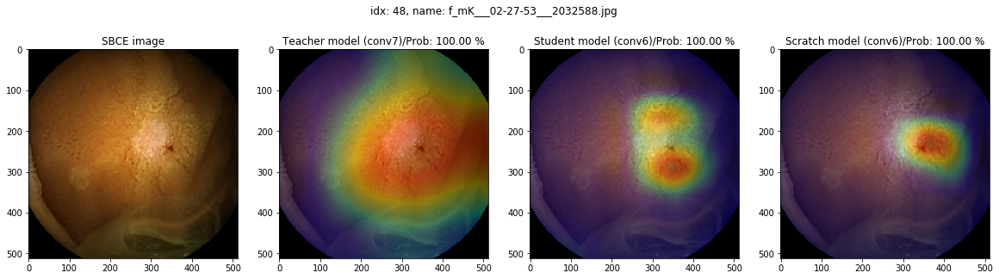

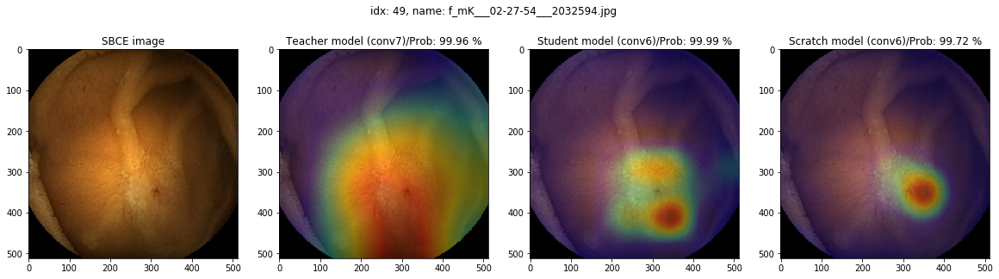

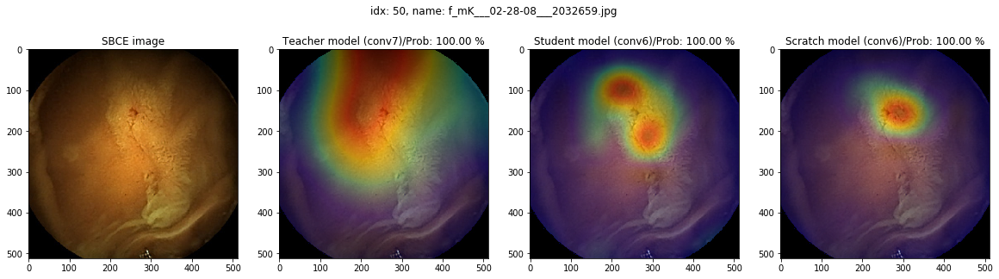

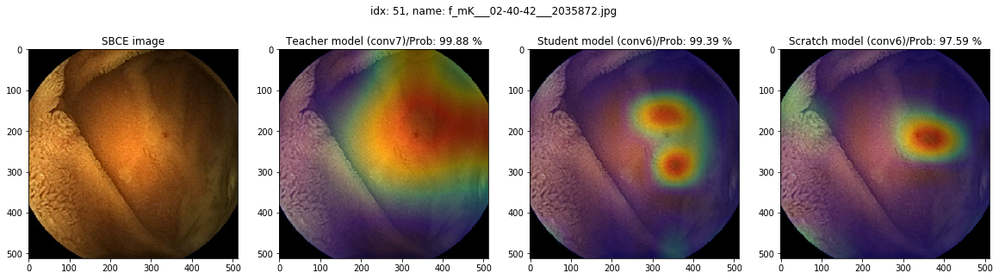

In [75]:
b_idxs = batch_idxs(tp_idx, batch_size = 10)

for i in b_idxs[4]:
    n = tp_idx[i]
    plt.figure(figsize = (20,6))
    plt.suptitle("idx: {}, name: {}".format(n, redspot_name[n]), y = 0.90)
    plt.subplot(141)
    plt.title("SBCE image")
    plt.imshow(redspot_data[n])
    plt.subplot(142)
    plt.title("Teacher model (conv7)/Prob: {:.2f} %".format(100*redspot_t_output[n, 1]))
    plt.imshow(redspot_data[n])
    plt.imshow(t_cams[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(143)
    plt.title("Student model (conv6)/Prob: {:.2f} %".format(100*redspot_stu_output[n, 1]))
    plt.imshow(redspot_data[n])
    plt.imshow(stu_cams[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(144)
    plt.title("Scratch model (conv6)/Prob: {:.2f} %".format(100*redspot_scr_output[n, 1]))
    plt.imshow(redspot_data[n])
    plt.imshow(scr_cams[i], cmap = 'jet', alpha = 0.3)
    plt.show()

In [116]:
b_idxs = batch_idxs(tp_idx)
t_cams, stu_cams, scr_cams = [], [], []
for b_idx in b_idxs:
    t_cam = teacher_conv7_model.get_gradcam(redspot_data[tp_idx[b_idx]], desired_cam = 'heatmap')
    stu_cam = student_conv6_model.get_gradcam(redspot_data[tp_idx[b_idx]], desired_cam = 'heatmap')
    scr_cam = scratch_conv6_model.get_gradcam(redspot_data[tp_idx[b_idx]], desired_cam = 'heatmap')
    t_cams.append(t_cam)
    stu_cams.append(stu_cam)
    scr_cams.append(scr_cam)

In [117]:
t_cams = batch_flatten(t_cams)
stu_cams = batch_flatten(stu_cams)
scr_cams = batch_flatten(scr_cams)

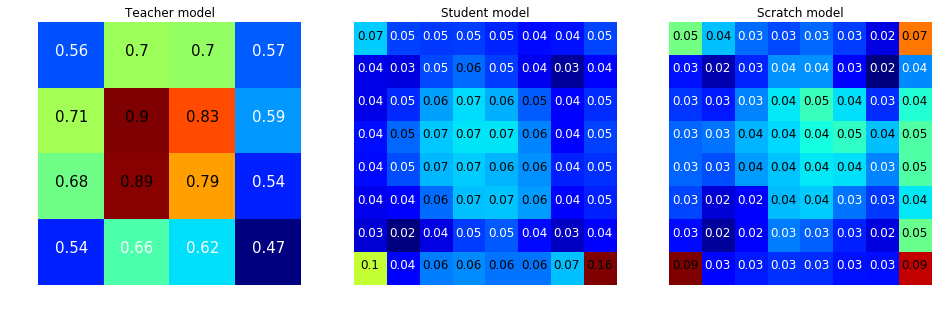

In [118]:
plt.figure(figsize=(16,8))
plt.subplot(131)
plt.title("Teacher model")
plot_heatmap(np.mean(t_cams, axis =0), font_size = 15)
plt.subplot(132)
plt.title("Student model")
plot_heatmap(np.mean(stu_cams, axis =0), font_size = 12)
plt.subplot(133)
plt.title("Scratch model")
plot_heatmap(np.mean(scr_cams, axis =0), font_size = 12)
plt.show()

### FN

In [76]:
t_cam = teacher_conv7_model.get_gradcam(redspot_data[fn_idx])
stu_cam = student_conv6_model.get_gradcam(redspot_data[fn_idx])
scr_cam = scratch_conv6_model.get_gradcam(redspot_data[fn_idx])

In [78]:
b_idxs = batch_idxs(fn_idx, batch_size = 10)

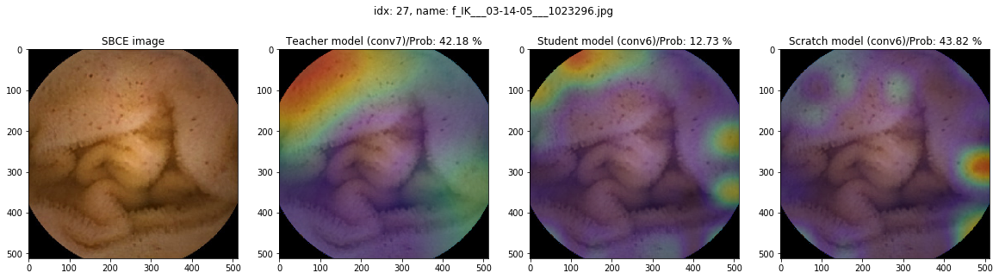

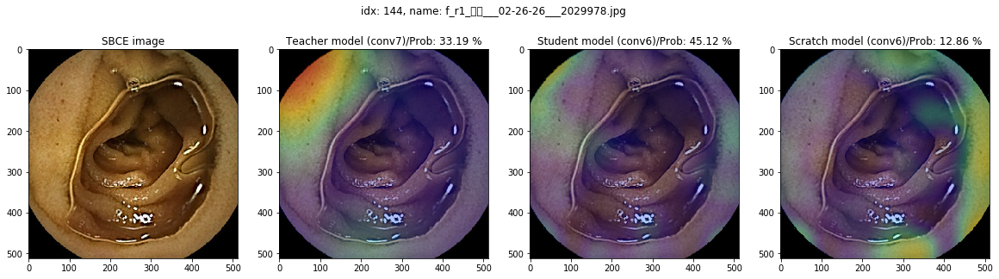

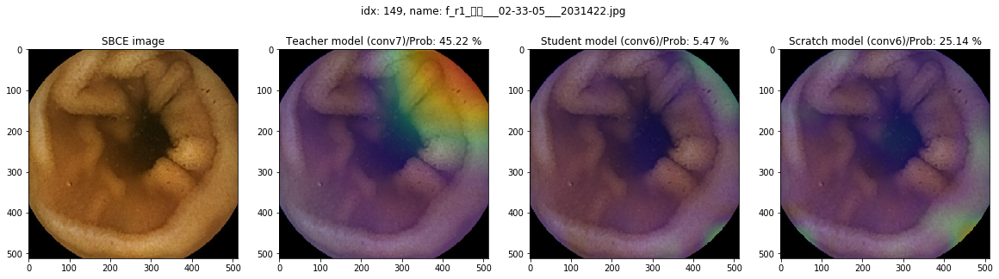

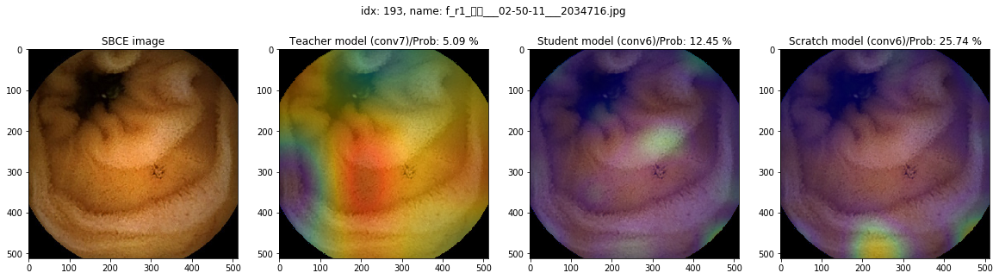

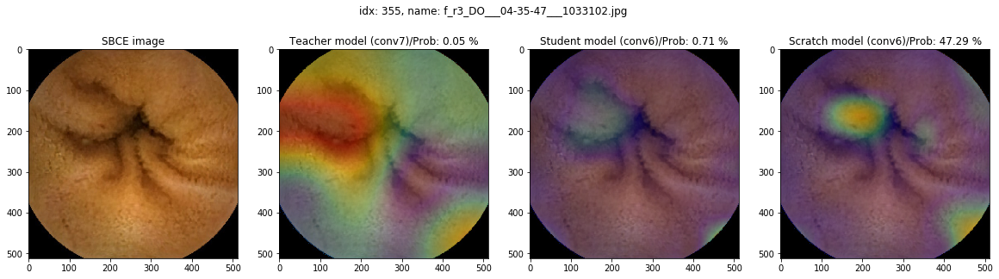

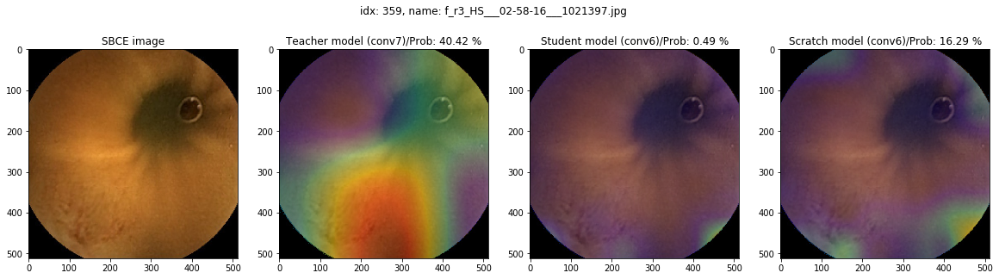

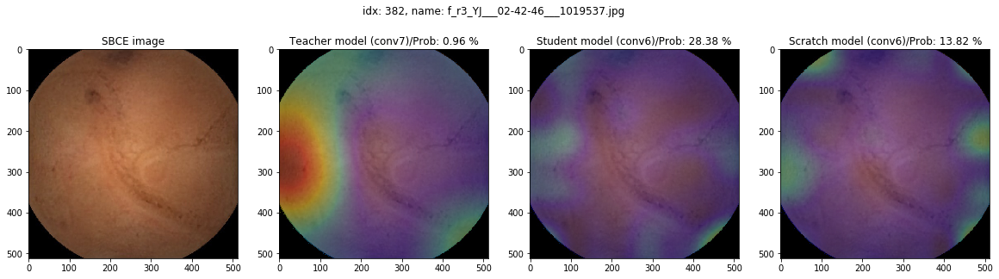

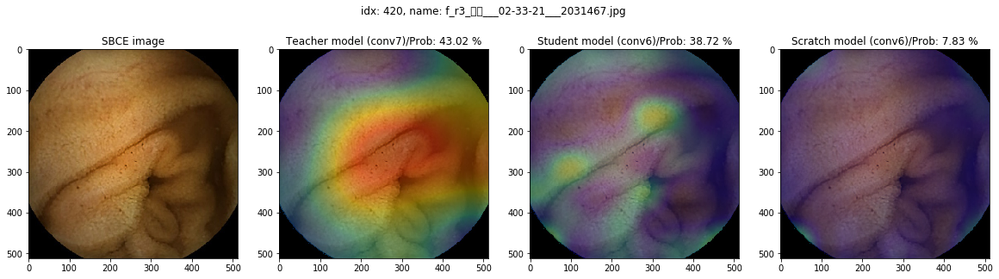

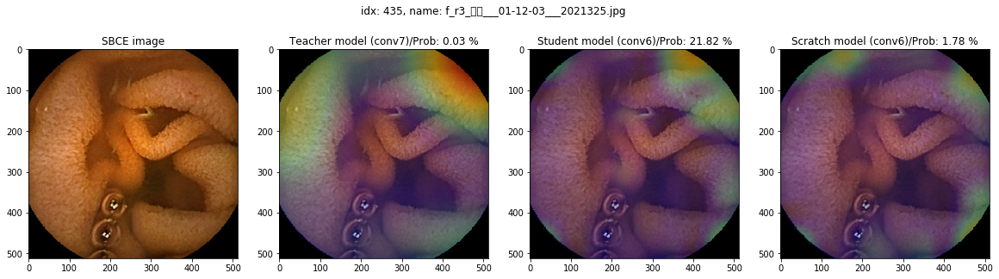

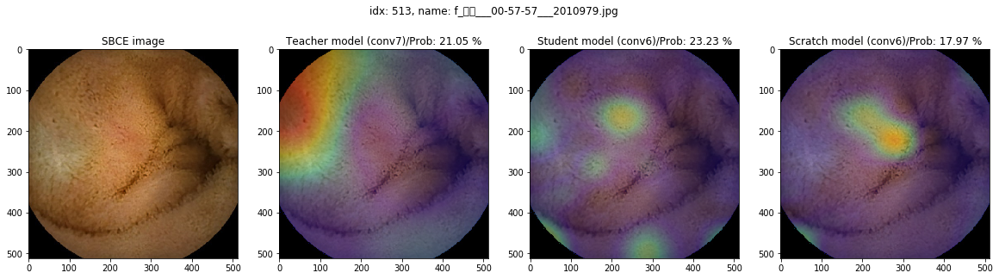

In [79]:
for i in b_idxs[0]:
    n = fn_idx[i]
    plt.figure(figsize = (20,6))
    plt.suptitle("idx: {}, name: {}".format(n, redspot_name[n]), y = 0.90)
    plt.subplot(141)
    plt.title("SBCE image")
    plt.imshow(redspot_data[n])
    plt.subplot(142)
    plt.title("Teacher model (conv7)/Prob: {:.2f} %".format(100*redspot_t_output[n, 1]))
    plt.imshow(redspot_data[n])
    plt.imshow(t_cam[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(143)
    plt.title("Student model (conv6)/Prob: {:.2f} %".format(100*redspot_stu_output[n, 1]))
    plt.imshow(redspot_data[n])
    plt.imshow(stu_cam[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(144)
    plt.title("Scratch model (conv6)/Prob: {:.2f} %".format(100*redspot_scr_output[n, 1]))
    plt.imshow(redspot_data[n])
    plt.imshow(scr_cam[i], cmap = 'jet', alpha = 0.3)
    plt.show()

## Angioectasia

In [80]:
tp_t_idx, fn_t_idx = confusion_idx(angio_label, angio_t_output, cls = 'positive')
tp_stu_idx, fn_stu_idx = confusion_idx(angio_label, angio_stu_output, cls = 'positive')
tp_scr_idx, fn_scr_idx = confusion_idx(angio_label, angio_scr_output, cls = 'positive')

print("Teacher: TPs = {}, FNs = {}".format(len(tp_t_idx), len(fn_t_idx)))
print("Student: TPs = {}, FNs = {}".format(len(tp_stu_idx), len(fn_stu_idx)))
print("Scratch: TPs = {}, FNs = {}".format(len(tp_scr_idx), len(fn_scr_idx)))

Teacher: TPs = 37, FNs = 0
Student: TPs = 37, FNs = 0
Scratch: TPs = 37, FNs = 0


In [81]:
tp_idx = np.intersect1d(tp_t_idx, tp_stu_idx)
tp_idx = np.intersect1d(tp_idx, tp_scr_idx)

fn_idx = np.intersect1d(fn_t_idx, fn_stu_idx)
fn_idx = np.intersect1d(fn_idx, fn_scr_idx)

print("Common TPs = {}, FNs = {}".format(len(tp_idx), len(fn_idx)))

Common TPs = 37, FNs = 0


### TP

In [82]:
t_cam = teacher_conv7_model.get_gradcam(angio_data[tp_idx])
stu_cam = student_conv6_model.get_gradcam(angio_data[tp_idx])
scr_cam = scratch_conv6_model.get_gradcam(angio_data[tp_idx])

In [83]:
b_idxs = batch_idxs(tp_idx, batch_size = 10)

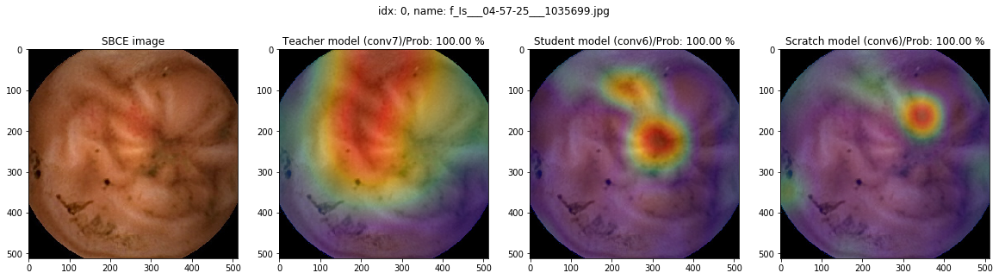

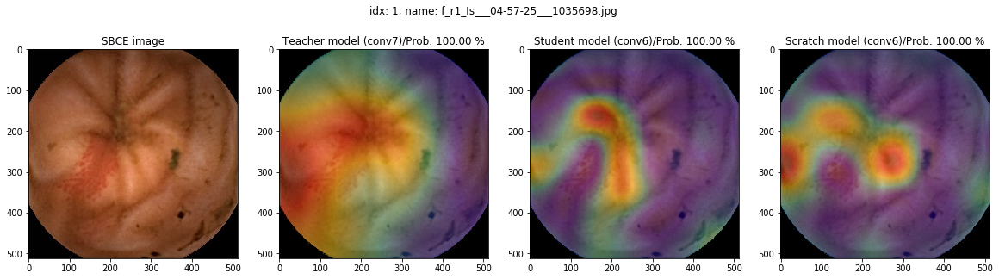

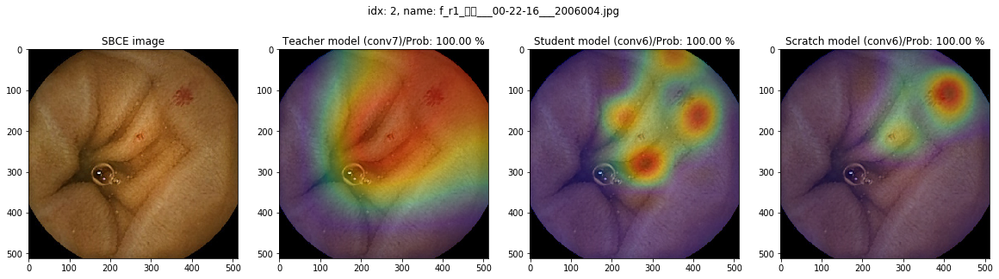

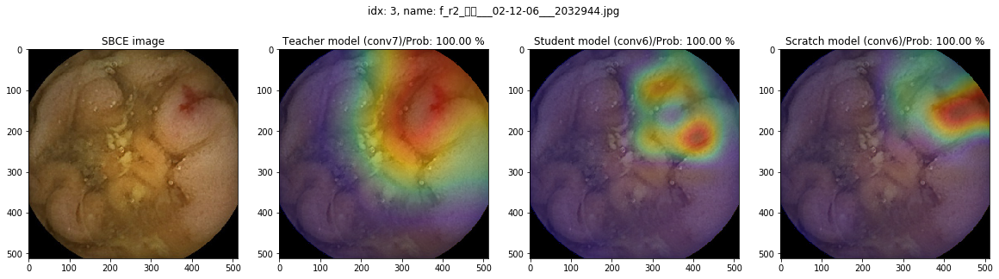

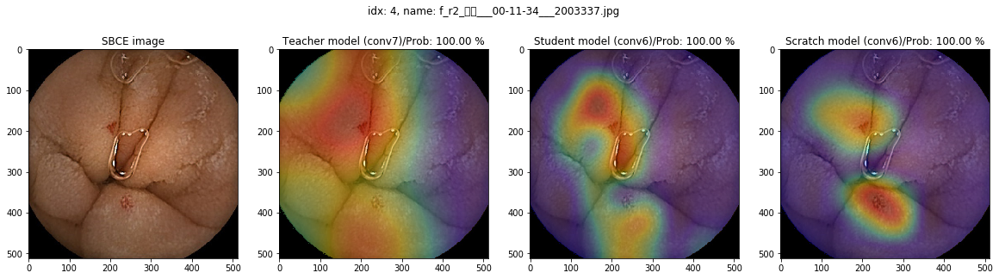

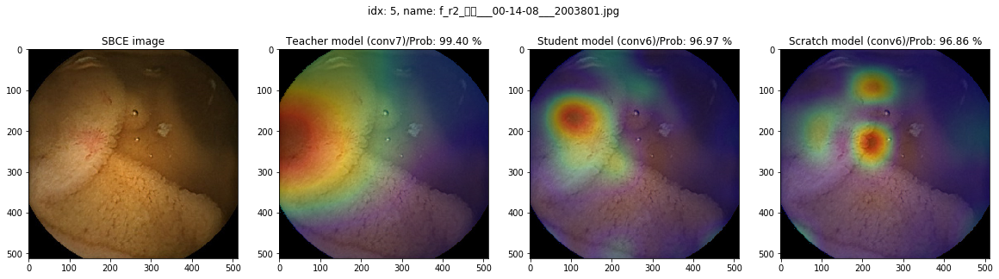

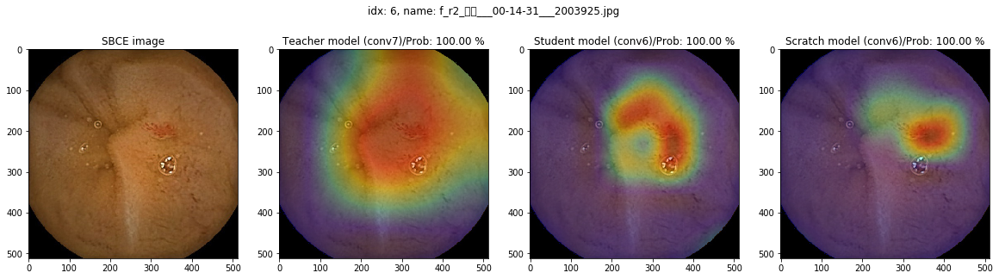

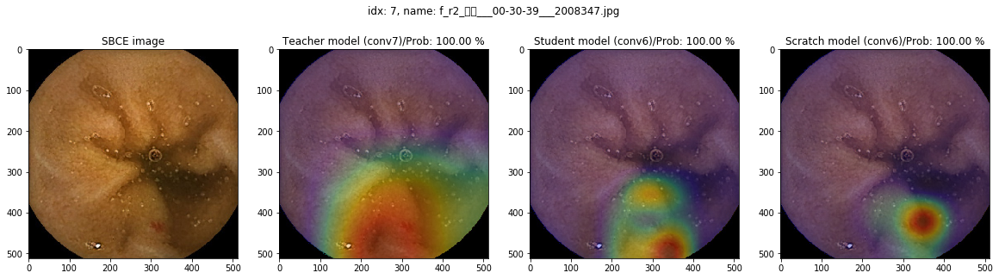

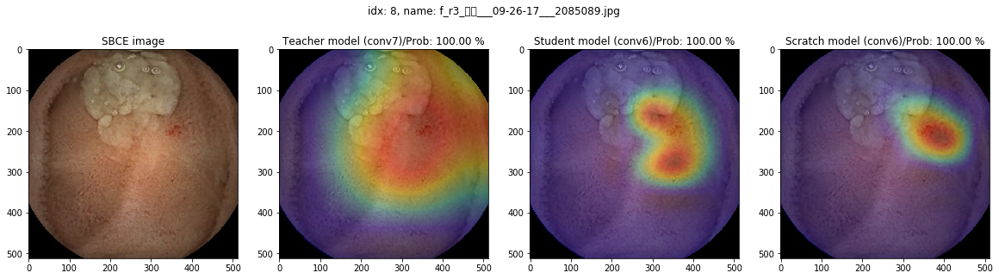

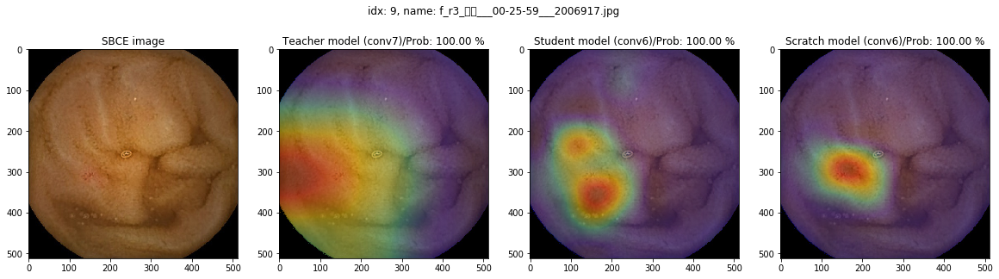

In [85]:
for i in b_idxs[0]:
    n = tp_idx[i]
    plt.figure(figsize = (20,6))
    plt.suptitle("idx: {}, name: {}".format(n, angio_name[n]), y = 0.90)
    plt.subplot(141)
    plt.title("SBCE image")
    plt.imshow(angio_data[n])
    plt.subplot(142)
    plt.title("Teacher model (conv7)/Prob: {:.2f} %".format(100*angio_t_output[n, 1]))
    plt.imshow(angio_data[n])
    plt.imshow(t_cam[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(143)
    plt.title("Student model (conv6)/Prob: {:.2f} %".format(100*angio_stu_output[n, 1]))
    plt.imshow(angio_data[n])
    plt.imshow(stu_cam[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(144)
    plt.title("Scratch model (conv6)/Prob: {:.2f} %".format(100*angio_scr_output[n, 1]))
    plt.imshow(angio_data[n])
    plt.imshow(scr_cam[i], cmap = 'jet', alpha = 0.3)
    plt.show()

In [87]:
t_cam = teacher_conv7_model.get_gradcam(angio_data[tp_idx], desired_cam = 'heatmap')
stu_cam = student_conv6_model.get_gradcam(angio_data[tp_idx], desired_cam = 'heatmap')
scr_cam = scratch_conv6_model.get_gradcam(angio_data[tp_idx], desired_cam = 'heatmap')

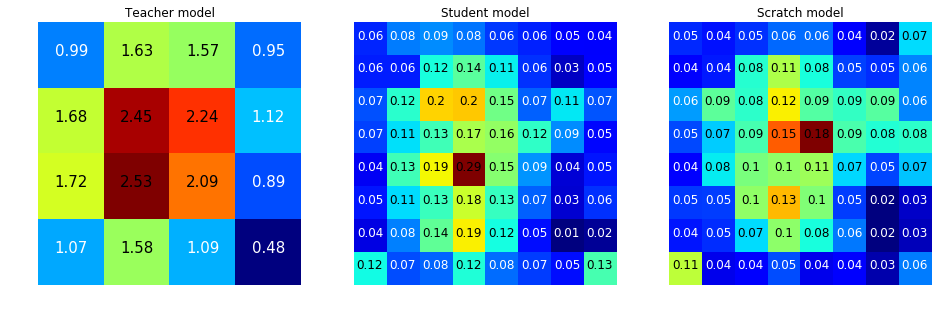

In [89]:
plt.figure(figsize=(16,8))
plt.subplot(131)
plt.title("Teacher model")
plot_heatmap(np.mean(t_cam, axis =0), font_size = 15)
plt.subplot(132)
plt.title("Student model")
plot_heatmap(np.mean(stu_cam, axis =0), font_size = 12)
plt.subplot(133)
plt.title("Scratch model")
plot_heatmap(np.mean(scr_cam, axis =0), font_size = 12)
plt.show()

## Active Bleeding

In [90]:
tp_t_idx, fn_t_idx = confusion_idx(active_label, active_t_output, cls = 'positive')
tp_stu_idx, fn_stu_idx = confusion_idx(active_label, active_stu_output, cls = 'positive')
tp_scr_idx, fn_scr_idx = confusion_idx(active_label, active_scr_output, cls = 'positive')

print("Teacher: TPs = {}, FNs = {}".format(len(tp_t_idx), len(fn_t_idx)))
print("Student: TPs = {}, FNs = {}".format(len(tp_stu_idx), len(fn_stu_idx)))
print("Scratch: TPs = {}, FNs = {}".format(len(tp_scr_idx), len(fn_scr_idx)))

Teacher: TPs = 856, FNs = 2
Student: TPs = 855, FNs = 3
Scratch: TPs = 853, FNs = 5


In [91]:
tp_idx = np.intersect1d(tp_t_idx, tp_stu_idx)
tp_idx = np.intersect1d(tp_idx, tp_scr_idx)

fn_idx = np.intersect1d(fn_t_idx, fn_stu_idx)
fn_idx = np.intersect1d(fn_idx, fn_scr_idx)

print("Common TPs = {}, FNs = {}".format(len(tp_idx), len(fn_idx)))

Common TPs = 850, FNs = 0


### TP

In [92]:
b_idxs = batch_idxs(tp_idx)

In [93]:
t_cams, stu_cams, scr_cams = [], [], []
for b_idx in b_idxs:
    t_cam = teacher_conv7_model.get_gradcam(active_data[tp_idx[b_idx]])
    stu_cam = student_conv6_model.get_gradcam(active_data[tp_idx[b_idx]])
    scr_cam = scratch_conv6_model.get_gradcam(active_data[tp_idx[b_idx]])
    t_cams.append(t_cam)
    stu_cams.append(stu_cam)
    scr_cams.append(scr_cam)

In [94]:
t_cams = batch_flatten(t_cams)
stu_cams = batch_flatten(stu_cams)
scr_cams = batch_flatten(scr_cams)

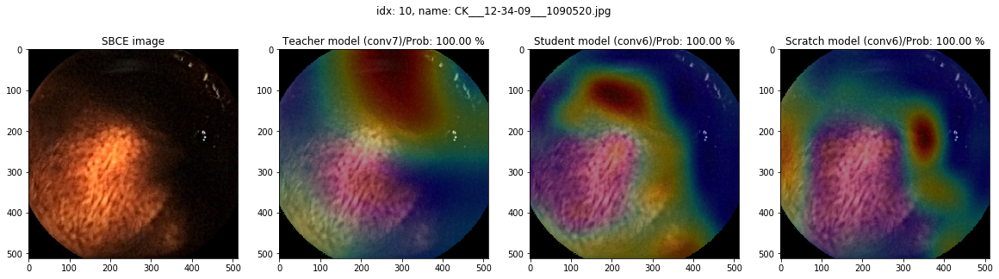

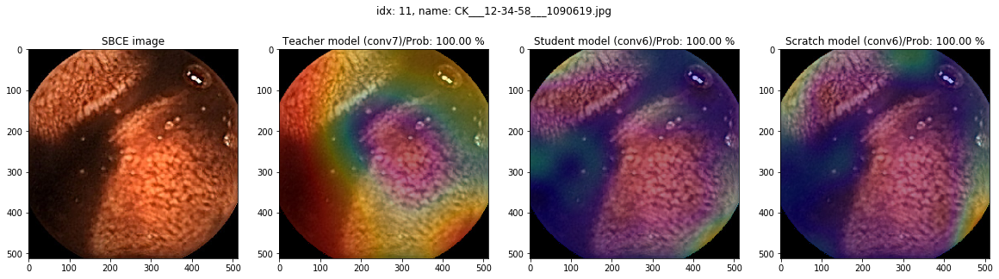

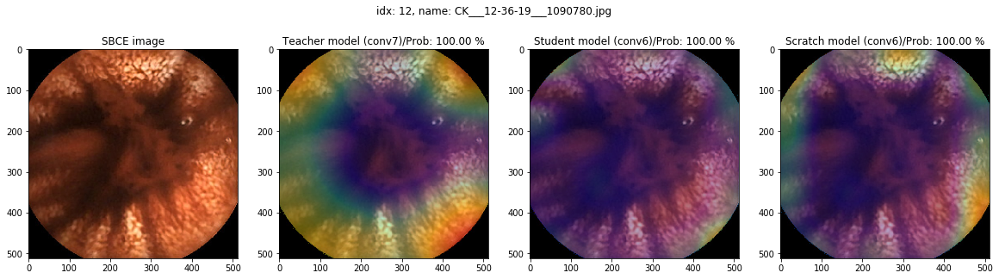

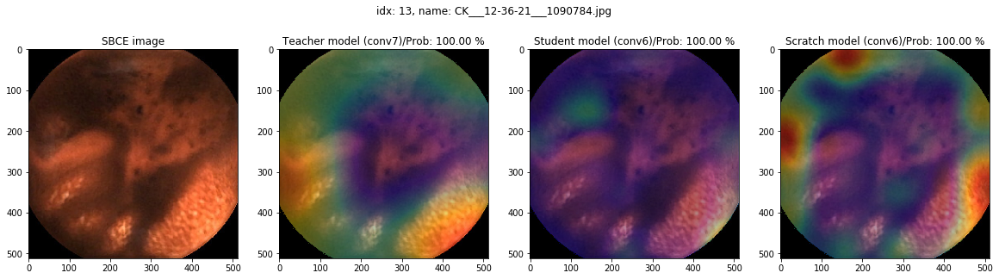

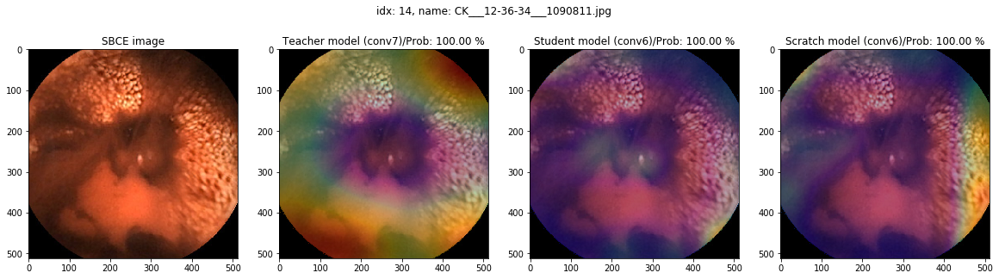

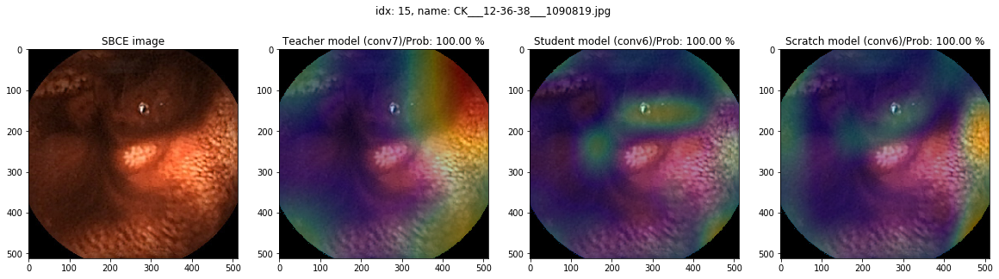

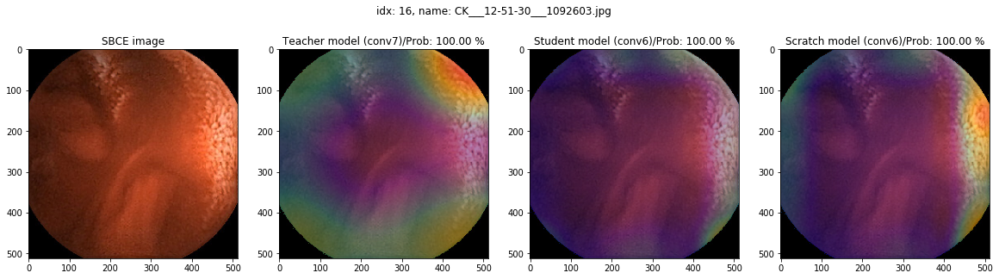

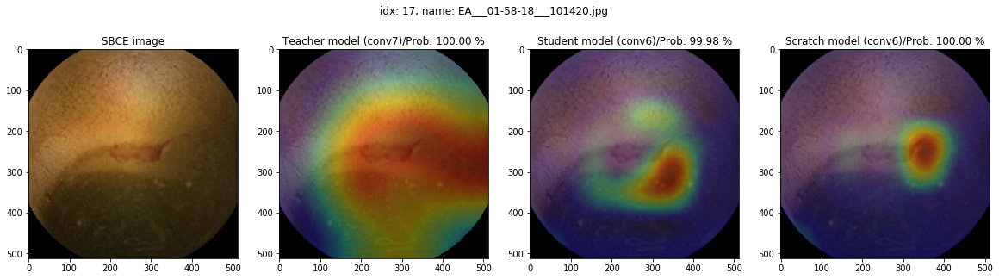

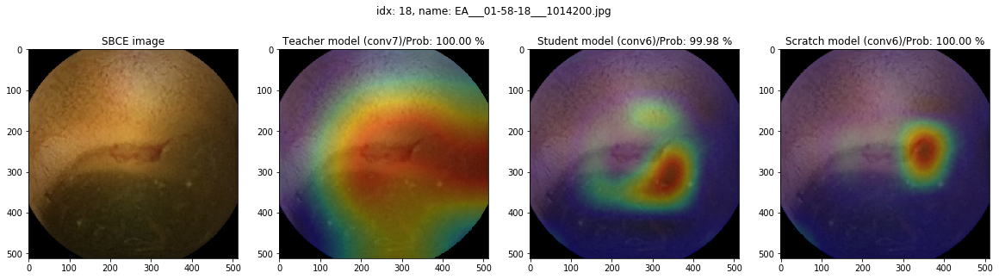

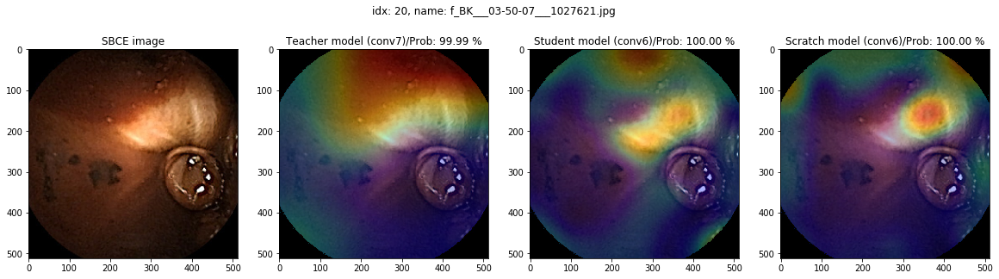

In [97]:
b_idxs = batch_idxs(tp_idx, batch_size = 10)

for i in b_idxs[1]:
    n = tp_idx[i]
    plt.figure(figsize = (20,6))
    plt.suptitle("idx: {}, name: {}".format(n, active_name[n]), y = 0.90)
    plt.subplot(141)
    plt.title("SBCE image")
    plt.imshow(active_data[n])
    plt.subplot(142)
    plt.title("Teacher model (conv7)/Prob: {:.2f} %".format(100*active_t_output[n, 1]))
    plt.imshow(active_data[n])
    plt.imshow(t_cams[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(143)
    plt.title("Student model (conv6)/Prob: {:.2f} %".format(100*active_stu_output[n, 1]))
    plt.imshow(active_data[n])
    plt.imshow(stu_cams[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(144)
    plt.title("Scratch model (conv6)/Prob: {:.2f} %".format(100*active_scr_output[n, 1]))
    plt.imshow(active_data[n])
    plt.imshow(scr_cams[i], cmap = 'jet', alpha = 0.3)
    plt.show()

In [111]:
b_idxs = batch_idxs(tp_idx)
t_cams, stu_cams, scr_cams = [], [], []
for b_idx in b_idxs:
    t_cam = teacher_conv7_model.get_gradcam(active_data[tp_idx[b_idx]], desired_cam = 'heatmap')
    stu_cam = student_conv6_model.get_gradcam(active_data[tp_idx[b_idx]], desired_cam = 'heatmap')
    scr_cam = scratch_conv6_model.get_gradcam(active_data[tp_idx[b_idx]], desired_cam = 'heatmap')
    t_cams.append(t_cam)
    stu_cams.append(stu_cam)
    scr_cams.append(scr_cam)

In [112]:
t_cams = batch_flatten(t_cams)
stu_cams = batch_flatten(stu_cams)
scr_cams = batch_flatten(scr_cams)

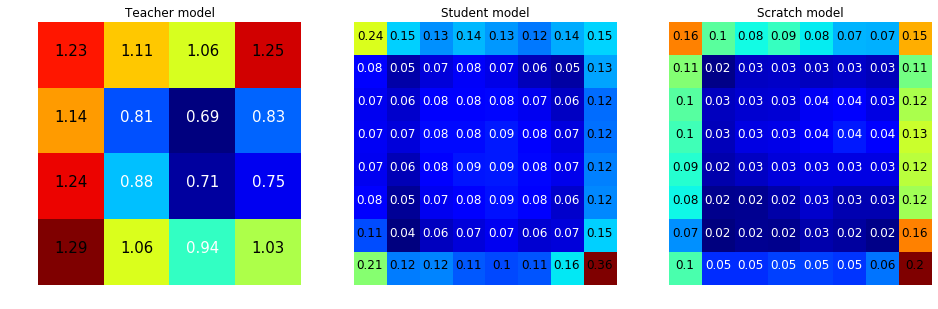

In [113]:
plt.figure(figsize=(16,8))
plt.subplot(131)
plt.title("Teacher model")
plot_heatmap(np.mean(t_cams, axis =0), font_size = 15)
plt.subplot(132)
plt.title("Student model")
plot_heatmap(np.mean(stu_cams, axis =0), font_size = 12)
plt.subplot(133)
plt.title("Scratch model")
plot_heatmap(np.mean(scr_cams, axis =0), font_size = 12)
plt.show()

## Negative

In [122]:
tn_t_idx, fp_t_idx = confusion_idx(neg_label, neg_t_output, cls = 'negative')
tn_stu_idx, fp_stu_idx = confusion_idx(neg_label, neg_stu_output, cls = 'negative')
tn_scr_idx, fp_scr_idx = confusion_idx(neg_label, neg_scr_output, cls = 'negative')

print("Teacher: TNs = {}, FPs = {}".format(len(tn_t_idx), len(fp_t_idx)))
print("Student: TNs = {}, FPs = {}".format(len(tn_stu_idx), len(fp_stu_idx)))
print("Scratch: TNs = {}, FPs = {}".format(len(tn_scr_idx), len(fp_scr_idx)))

Teacher: TNs = 12228, FPs = 286
Student: TNs = 12086, FPs = 428
Scratch: TNs = 11886, FPs = 628


In [123]:
tn_idx = np.intersect1d(tn_t_idx, tn_stu_idx)
tn_idx = np.intersect1d(tn_idx, tn_scr_idx)

fp_idx = np.intersect1d(fp_t_idx, fp_stu_idx)
fp_idx = np.intersect1d(fp_idx, fp_scr_idx)

print("Common TNs = {}, FPs = {}".format(len(tn_idx), len(fp_idx)))

Common TNs = 11642, FPs = 132


### FP

In [124]:
b_idxs = batch_idxs(fp_idx)

In [125]:
t_cams, stu_cams, scr_cams = [], [], []
for b_idx in b_idxs:
    t_cam = teacher_conv7_model.get_gradcam(neg_data[fp_idx[b_idx]])
    stu_cam = student_conv6_model.get_gradcam(neg_data[fp_idx[b_idx]])
    scr_cam = scratch_conv6_model.get_gradcam(neg_data[fp_idx[b_idx]])
    t_cams.append(t_cam)
    stu_cams.append(stu_cam)
    scr_cams.append(scr_cam)

In [126]:
t_cams = batch_flatten(t_cams)
stu_cams = batch_flatten(stu_cams)
scr_cams = batch_flatten(scr_cams)

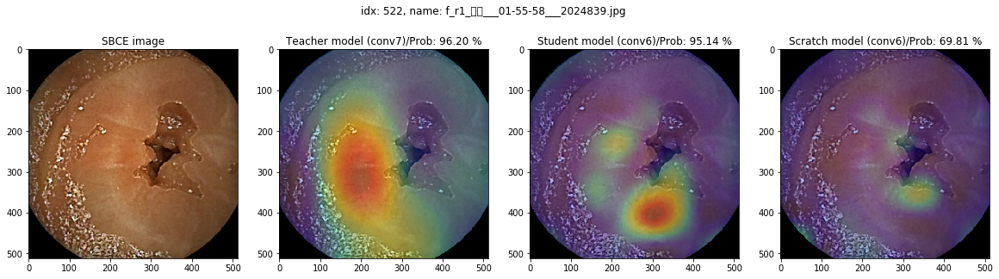

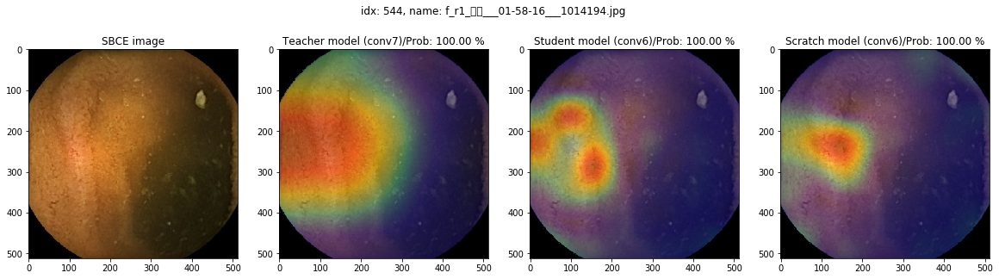

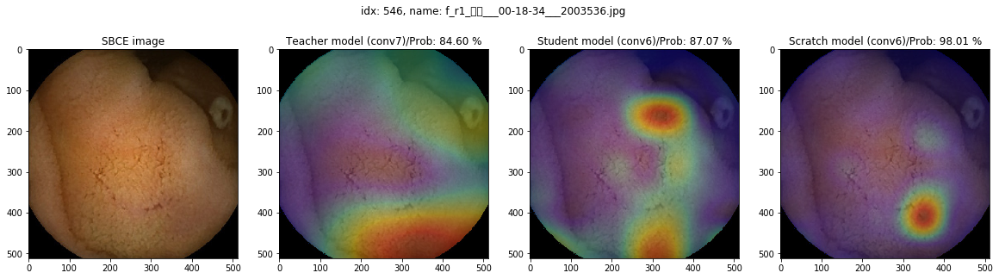

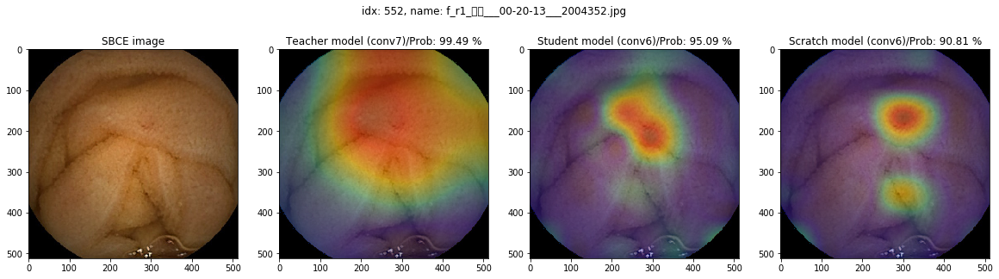

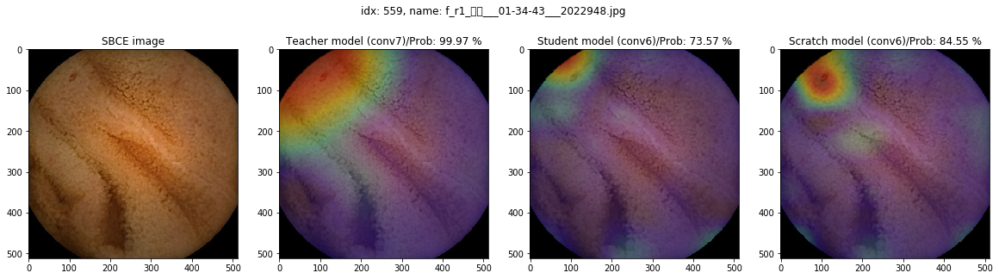

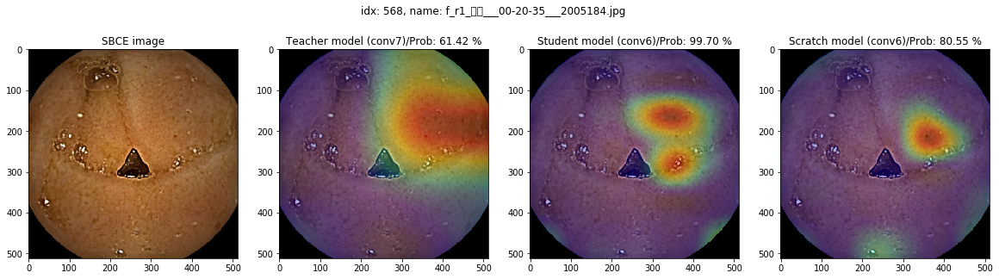

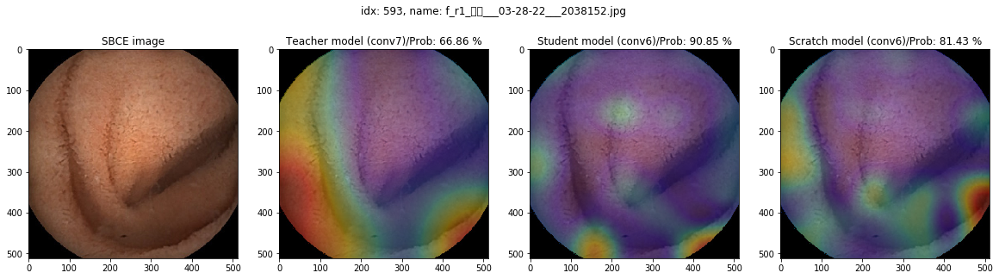

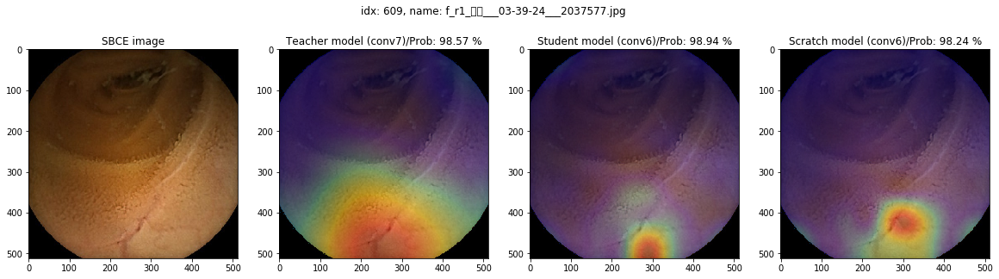

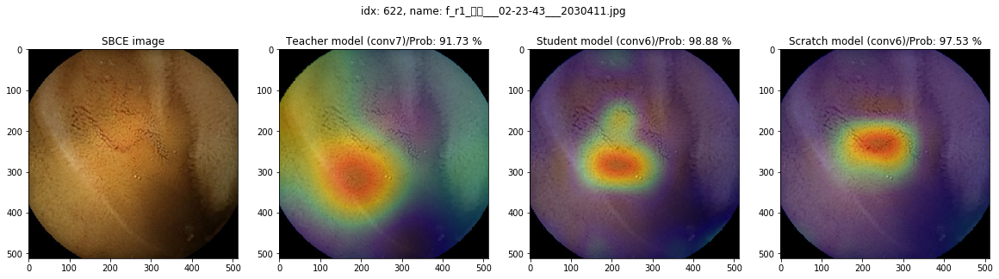

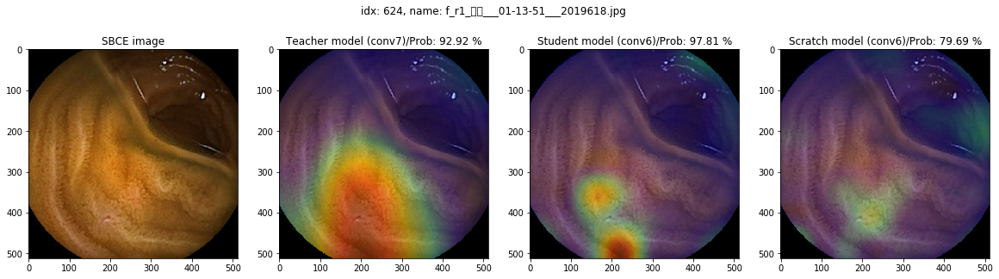

In [129]:
b_idxs = batch_idxs(fp_idx, batch_size = 10)

for i in b_idxs[1]:
    n = fp_idx[i]
    plt.figure(figsize = (20,6))
    plt.suptitle("idx: {}, name: {}".format(n, neg_name[n]), y = 0.90)
    plt.subplot(141)
    plt.title("SBCE image")
    plt.imshow(neg_data[n])
    plt.subplot(142)
    plt.title("Teacher model (conv7)/Prob: {:.2f} %".format(100*neg_t_output[n, 1]))
    plt.imshow(neg_data[n])
    plt.imshow(t_cams[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(143)
    plt.title("Student model (conv6)/Prob: {:.2f} %".format(100*neg_stu_output[n, 1]))
    plt.imshow(neg_data[n])
    plt.imshow(stu_cams[i], cmap = 'jet', alpha = 0.3)
    plt.subplot(144)
    plt.title("Scratch model (conv6)/Prob: {:.2f} %".format(100*neg_scr_output[n, 1]))
    plt.imshow(neg_data[n])
    plt.imshow(scr_cams[i], cmap = 'jet', alpha = 0.3)
    plt.show()